# chapter 06 쓰기

In [1]:
from IPython.display import Image;

6장에서는 **텍스트 데이터**를 생성하는 모델을 만든다.

텍스트와 이미지 데이터 사이에는 몇 가지 큰 차이점이 존재한다.
    
=> 이러한 이유로 이미지 데이터에서 잘 작동하는 여러가지 방법을 텍스트 데이터에 쉽게 적용할 수 없다.

[ 차이점 ]

- 텍스트 데이터는 개별적인 데이터 조각(문자나 단어)로 구성된다. 반면 이미지 픽셀은 연속적인 색상 스펙트럼 위의 한 점이다. 개별 픽셀에 대한 손실 함수의 그레이디언트를 계산하면 손실 함수를 최소화하기 위해 픽셀의 색이 바뀌어야 할 방향을 알 수 있다. 그래서 이미지 데이터에는 역전파를 쉽게 적용할 수 있다. 이산적인 텍스트 데이터에는 일반적으로 **역전파를 적용할 수 없으므로 이 문제를 해결할 방법을 찾아야 한다.**


- 텍스트 데이터는 **시간 차원이 있지만 공간 차원이 없다**. 반면 이미지 데이터는 **두 개의 공간 차원이 있고 시간 차원이 없다.** 텍스트 데이터에서 단어의 순서는 매우 중요하다. 반면 이미지는 뒤집어도 콘텐츠에 영향을 미치지 않는다. 또한 단어 사이에는 모델이 감지해야 할 순서에 대한 의존성이 있는 경우가 많다. 예를 들면 질문에 대답하거나 대명사에 대한 문맥 정보를 다음 단계로 전달하는 경우이다. 이미지 데이터에서는 모든 픽셀이 동시에 처리될 수 있다.


- 텍스트 데이터는 개별 단위(문자나 단어)의 작은 변화에도 매우 민감하다. 이미지 데이터는 일반적으로 개별 픽셀 단위의 변화에 덜 민감하다. 집을 나타낸 그림에서 일부 픽셀이 바뀌더라도 여전히 집으로 인식할 수 있다. 하지만 텍스트 데이터에서 몇 개의 단어만 바꾸더라도 문장의 의미가 완전히 달라지거나 이해할 수 없게된다. 모든 단어가 문장 전체 의미를 나타내는 데 아주 중요하기 때문에 논리적인 텍스트를 생성하는 모델을 훈련하는 것이 매우 어렵다.


- 텍스트 데이터는 **규칙 기반을 가진 문법 구조를 가진다.** 반면 이미지는 픽셀값을 할당하기 위해 사전에 정의된 규칙이 없다. 예를 들면 문서에 'The cat sat on the having'과 같이 썼다면 문법적으로 올바르지 않다. 또한 의미론적인 규칙은 모델링을 하기 더욱 어렵다. 'I am in the beach'라는 문법적으로 문제는 없지만 의미가 통하지 않는다.

*텍스트 모델링이 진전을 보이고 있지만 위에서 나열한 문제점은 앞으로 지속적으로 해결해야 할 연구 영역이다. 먼저 순차 데이터(sequetial data)를 생성하는데 가장 유용하고 성공적인 모델 중에 하나인 순환 신경망(recurrent neural network)과 특히 LSTM(long short term memory)층에 대해 알아보자.*

# 6.2 LSTM 네트워크 소개

- **LSTM 네트워크**는 순환 신경망(RNN)의 한 종류이다. 


- RNN은 순차 데이터를 순환하는 층(또는 cell)이 있다. 


- 특정 타임스텝에 셀의 출력은 다음 타임스텝 입력의 일부분으로 사용된다 = >즉 과거의 정보가 현재 타임스텝의 예측에 영향을 미칠 수 있다

    **LSTM 순환층을 가진 신경망을 LSTM네트워크라고 말한다.**


- LSTM셀은 1997년 제프 호흐라이터와 위르겐 슈미트후버의 논문에서 처음 소개되었다.


- 논문에서 저자들은 기본 RNN에서 나타나는 그레이디언트 소실 문제를 어떻게 LSTM이 겪지 않고 수백 개의 타임스텝을 가진 긴 시퀀스에서 훈련할 수 있는지 설명했다. 

우선 이솝 우화 스타일로 텍스트를 생성하는 간단한 LSTM네트워크를 케라스로 구축해보자.

# 6.3 첫 번째 LSTM 네트워크

먼저 LSTM 네트워크를 훈련하기 위해 데이터를 적절한 형태로 가공하는 단계를 살펴보자

## 6.3.1 토큰화 ##

첫 번째 단계는 텍스트를 정제하고 토큰화한다. 

**토큰화**는 텍스트를 단어나 문자와 같은 개별 단위로 나누는 작업이다.

텍스트 생성 모델로 만드려는 종류에 따라 텍스트 토큰화 방법이 달라진다. 단어와 문자 토큰은 각기 장단점이 존재한다. 어떤 선택을 하는지에 따라 모델링 이전의 텍스트 정제 방법과 모델의 출력에 영향을 미친다.

**[ 단어 토큰의 경우 ]**

- 모든 텍스트를 소문자로 변환한다. 문장의 시작 부분에 첫 글자가 대문자인 단어를 문장의 중간에 등장하는 단어와 동일하게 토큰화되도록 만든다 => 하지만 경우에 따라 원치않은 결과를 보일 수 있다. 예를 들어, 사람 이름이나 지명 같은 고유 명사는 대문자 그대로 남겨두어 별도로 토큰화하는 것이 나을 수 있다.


- 어휘사전(훈련 세트에 있는 고유한 단어의 모음)이 매우 클 수 있다. 어떤 단어는 매우 드물게 등장하거나 딱 한 번만 나타날 수 있다. 희소한 단어는 **별도의 토큰으로 포함하기보다 알려지지 않은 단어(unknown word)에 해당하는 토큰으로 바꾸어 신경망이 학습해야할 가중치 수를 줄이는게 중요하다.**


- 단어에서 어간(stem)을 추출할 수 있다. 즉, 단어의 기본형으로 단순화하여 시제가 다른 동사를 하나로 토큰화 할 수 있다. 예를 들면 browse,browsing,browses,browsed는 어간이 모두 brows이다.


- 구두점(마침표와 쉼표)을 토큰화하거나 모두 제거해야 한다.


- 단어 토큰화를 사용하면 훈련 어휘 사전에 없는 단어는 모델이 예측할 수 없다.

**[ 문자 토큰의 경우 ]**

- 모델이 문자의 시퀀스를 생성해 훈련 어휘 사전에 없는 새로운 단어를 만들 수 있다. 경우에 따라 필요한 능력이거나 그렇지 않을 수 있다.


- 대문자는 소문자로 바꾸거나 별도의 토큰으로 남겨둘 수 있다.


- 문자 토큰화를 사용하면 어휘 사전은 비교적 매우 작다. 마지막 출력층에 학습할 가중치 수가 적기 때문에 모델 훈련 속도에 유리하다.

예제에서는 어간 추출없이 소문자 단어로 토큰화한다. 

모델이 문장의 끝이나 인용 부호의 시작과 끝을 예측하기 위해 구두점도 토큰화한다.

이야기 사이에 줄바꿈 문자는 새로운 이야기를 위한 구분자(||||||||||||||||||||)로 바꾼다.

이 모델을 사용해 텍스트를 생성하거나 처음부터 다시 새로운 이야기를 시작하기 위해 모델에 이 구분자를 주입할 수 있다.

In [ ]:
# 토큰화

import re
from keras.preprocessing.text import Tokenizer

filename="./data/aesop/data.txt"

with open(filename,encoding='uft-8-sig') as f:
    text = f.read()
    
seq_length = 20
start_story=' | ' *seq_length

#텍스트 정제
text = text.lower()
text = start_story + text
text = text.replace('\n\n\n\n\n',start_story)
text = text.replace('\n', '')
text = re.sub('  +', '. ', text).strip()
text = text.replace('..', '.')

text = re.sub('([!"#$%&()*+,-./:;<=>?@[\]^_'{|}~)', r' \1',text)
text = re.sub('\s{2,}', ' ',text)

# 토큰화
tokenizer = Tokenizer(char_lebel=False,filters='')
tokenizer.fit_on_texts([text])
total_words = len(tokenizer.word_index) +1  # 글에 만약 단어가 50종류 있으면 인덱스가 50개 있는거?
token_list = tokenizer.texts_to_wequences([text])[0x]

## 6.3.2 데이터셋 구축 ## 

LSTM 네트워크는 단어들의 시퀀스가 주어지면 이 시퀀스의 다음 단어를 예측하도록 훈련된다.

예를 들어, 'the greedy cat and the' 토큰을 주입하면 모델이 적절한 단어를 출력할 것이다(가령, 'in' 대신 'dog')

모델 훈련에 사용할 시퀀스 길이는 훈련 하이퍼파라미터이다. 이 예에서 길이가 20인 시퀀스를 사용한다. 따라서 텍스트를 20개의 단어 길이로 나눈다. 총50,416개의 시퀀스가 만들어지므로 훈련 데이터셋 X는 [50416,20]크기의 배열이 된다.

각 시퀀의 타깃은 다음 단어이다. 이 단어는 길이가 4,169(어휘 사전에 있는 고유한 단어의 개수)인 벡터로 원-핫 인코딩된다. 따라서 타깃 y는 [50416,4169] 크기의 0 또는 1을 가진 이진 배열이다.

In [ ]:
# 데이터셋 생성

import numpy as np
from keras.utils import np_utils

def generate_sequence(token_list,step):
    X = []
    y = []
    
    for i in range(0,len(token_list) - seq_length,step):
        X.append(token_list[i:i+seq_length])
        y.append(token_list[i:i+seq_length])
    y = np_utils.to_categorical(y,num_classes = total_words)
    num_seq = len(X)
    print('시퀀스 개수:',num_seq,"\n")
    
    return X,y,num_seq

step = 1
seq_length = 20
X,y,num_seq = generate_sequence(token_list,step)

X=np.array(X)
y=np.array(y)

## 6.3.3 LSTM 모델 구조 ##

전체 모델의 구조는 다음 그림과 같다.

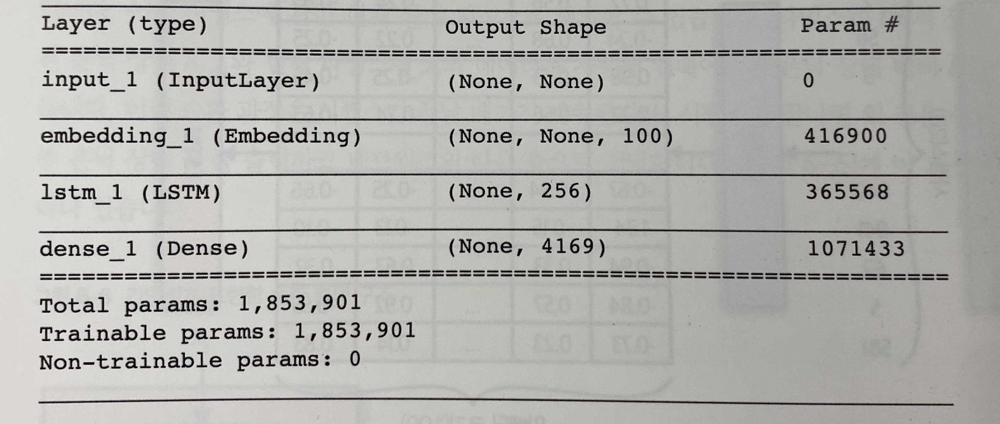

모델의 입력은 정수 토큰의 시퀀스이고 출력은 시퀀스 다음에 어휘 사전에서 등장할 수 있는 단어의 확률이다.

작동방식을 자세히 이해하기 위해 새로 등장한 임베딩 층과 LSTM층을 소개할 것이다.

## 6.3.4 임베딩 층 ##

**임베딩층**은 기본적으로 각 토큰은 embedding_size길이의 벡터로 변환하는 룩업 테이블이다.

따라서 이 층에서 학습되는 가중치 개수는 어휘 사전의 크기에 embedding_size를 곱한 값이다.

📍 *워드 임베딩이란? 텍스트 내의 단어들을 밀집 벡터(dense vector)로 만드는 것을 말한다.*

Input층은 [batch_size, seq_length]크기의 정수 시퀀스를 텐서 Embedding층으로 전달하면 이 층은 [batch_size,seq_length,embedding_size]의 크기의 텐서를 출력한다.

이 텐서가 LSTM층으로 전달된다.

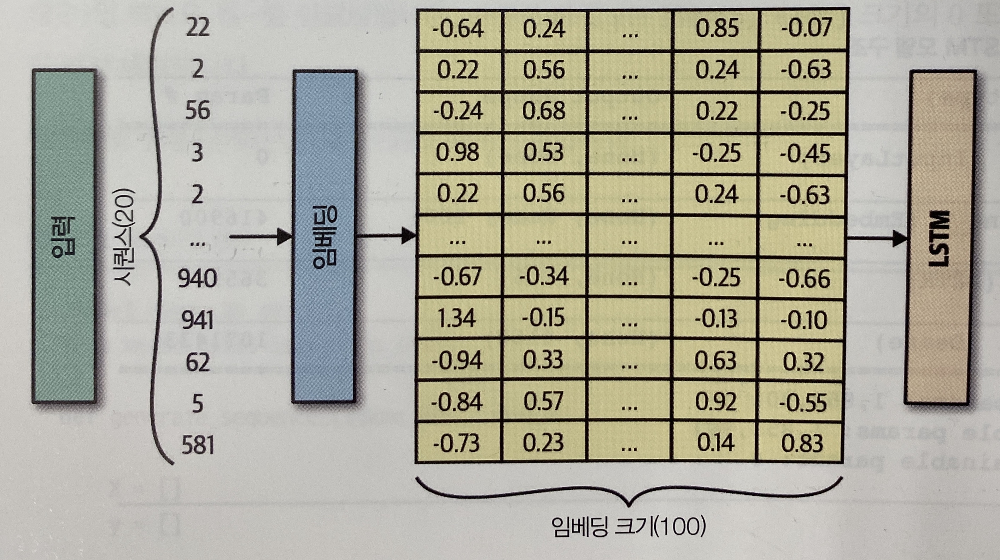

In [2]:
Image("img/1.jpg")

모델이 역전파를 통해 업데이트가 가능한 단어 표현을 학습할 수 있기 때문에 **각 정수 토큰이 연속적인 벡터로 임베딩 된다.**

입력 토큰을 원-핫 인코딩할 수도 있지만 임베딩 층이 더 선호된다.

임베딩 층은 스스로 학습할 수 있기 때문에 성능을 향상시키기 위해 모델이 토큰의 임베딩 방법을 자유롭게 결정할 수 있기 때문이다.

## 6.3.5 LSTM 층 ##

LSTM층을 이해하기 위해 먼저 일반적인 순환 층이 어떻게 작동하는지 알아보자.

순환 층은 순차적인 입력데이터 [x_1,x_2,x_3,~, x_n]를 처리할 수 있는 특별한 구조를 가지고 있다.

순환 층은 셀로 구성된다. 

은닉 상태 h_t는 한 번에 한 타임스텝씩 시퀀스 x_t의 각 원소를 셀로 전달해 업데이트한다.

은닉 상태는 셀 안에 있는 유닛의 갯수와 길이가 동일한 벡터이다. 이를 시퀀스에 관한 현재 셀의 지식으로 생각할 수 있다.

**타임스텝 t에서 셀은 이전 은닉상태 h_t-1와 현재 타임스텝 x_t의 데이터를 사용해 업데이트된 은닉상태 벡터 h_t를 만든다. 이런 순환 과정은 시퀀스가 끝날 때 까지 계속된다.**

시퀀스가 끝나면 이 층은 셀의 최종 은닉 상태 h_n을 출력하고 네트워크의 다음층으로 전달한다.

다음 그림에 이 과정이 나와있다.

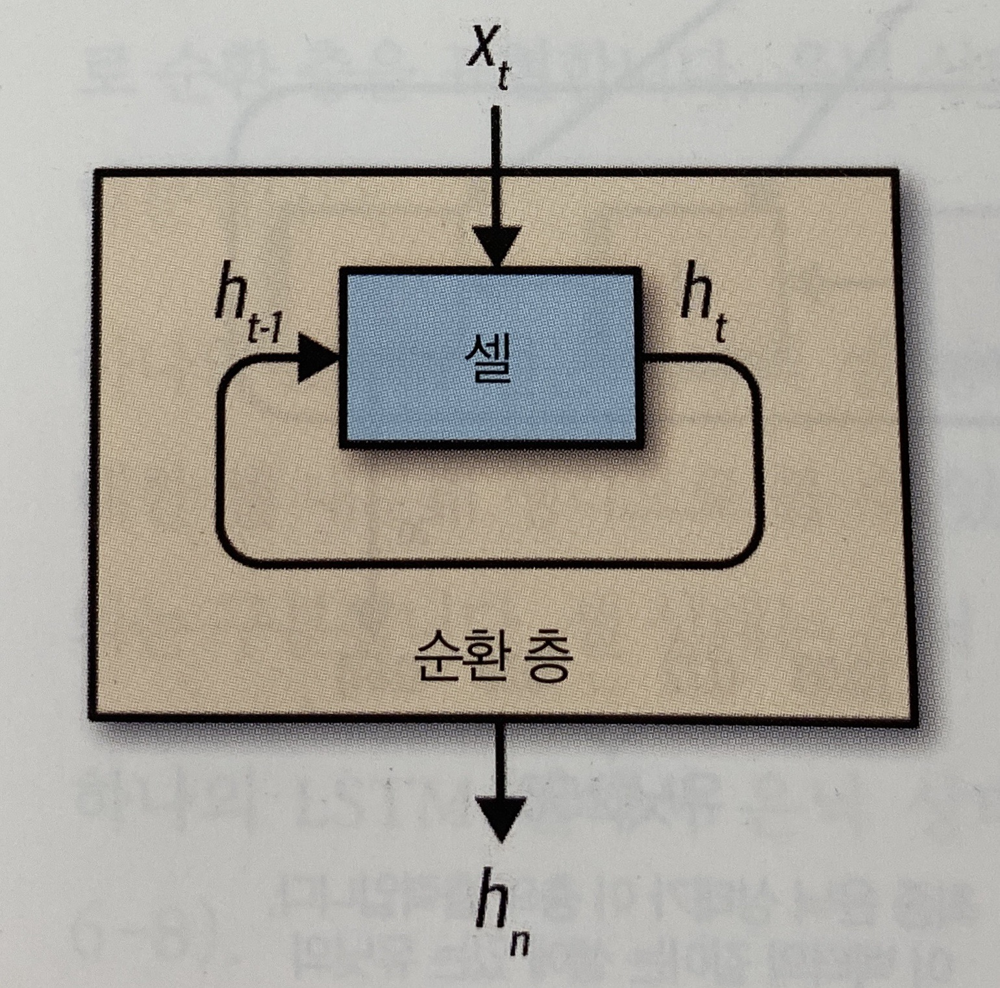

In [3]:
Image("img/2.jpg")

좀 더 자세한 설명을 위해 하나의 시퀀스가 순환 층에 주입된 과정을 시간 순으로 펼치면 다음 그림과 같다.

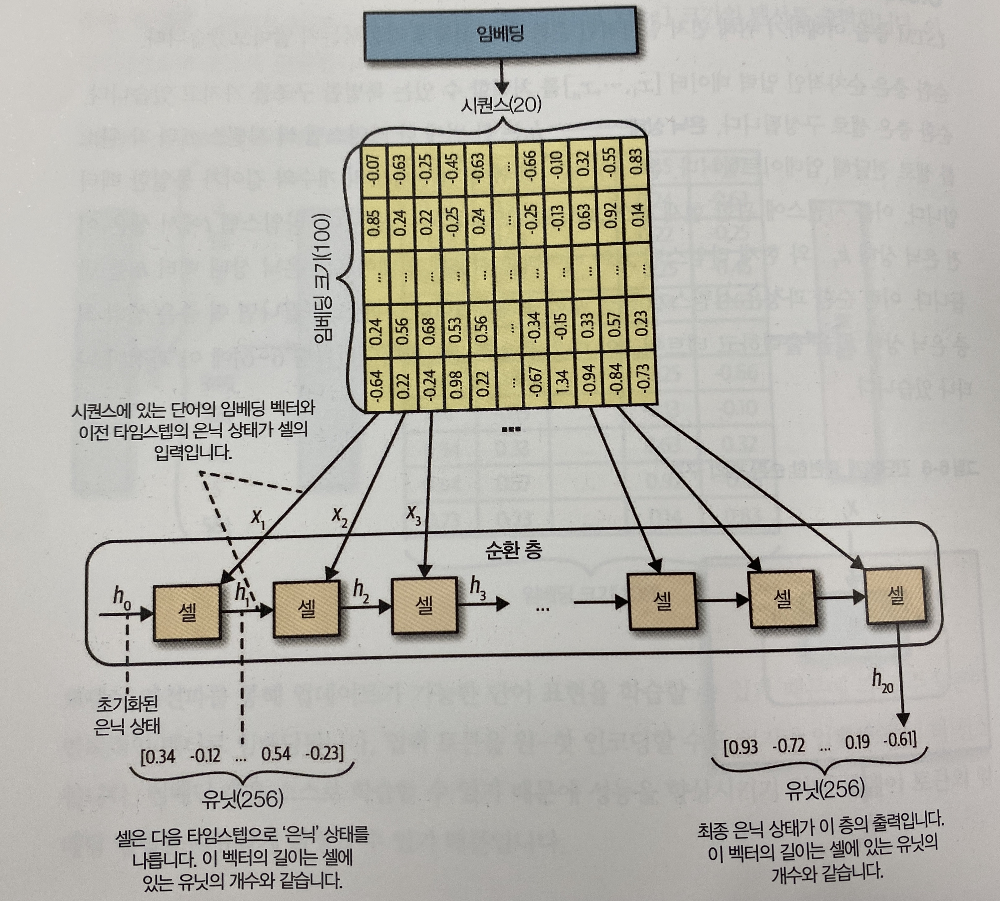

In [4]:
Image("img/3.jpg")

여기에서는 타임스텝마다 셀을 그려서 순환과정을 표현했다.

은닉 상태는 셀을 통과하여 흘러감에 따라 계속 업데이트 된다. 이전 은닉 상태가 현재의 순차 데이터 포인트(즉, 현재의 임베딩 단어 벡터)와 어떻게 합쳐져 다음 은닉 상태를 만드는지 볼 수 있다. **이 층의 출력은 입력 시퀀스의 모든 단어가 처리된 후 만들어진 셀의 마지막 은닉 상태이다.**

이 그림에 모든 셀은 동일한 가중치를 공유한다. 이것이 아주 중요하다.

## 6.3.6 LSTM 셀 ##

일반적인 순환 층의 작동 방식을 보았으므로 이제 LSTM셀의 내부를 확인해보자.

LSTM 셀은 이전 은닉 상태 h_t-1과 현재 단어 임베딩 x_t가 주어졌을 때 새로운 은닉 상태 h_t를 출력한다.

h_t의 길이는 LSTM에 있는 유닛의 개수와 동일하다. 이는 층을 정의할 때 지정해야하는 하이퍼파라미터이며 시퀀스의 길이와는 아무 상관이 없다.

**=> 셀과 유닛 혼동 하지 말 것**

LSTM 층에는 하나의 셀이 있고 이 셀은 여러개의 유닛을 포함한다. 감방에 여러 명의 죄수가 수감된 것과 동일하다.

종종 셀을 펼쳐서 연결한 것으로 순환층을 표현한다. 은닉 상태가 매 타임스텝에서 어떻게 업데이트 되는지 나타내기 좋기 때문이다.

하나의 LSTM 셀은 하나의 셀 상태 C_t를 관리한다. 셀 상태를 현재 시퀀스 상태에 대한 셀 내부의 생각으로 볼 수 있다. 

마지막 타임스텝 후에 셀에서 출력되는 은닉 상태 h_t와는 구분된다. 셀 상태는 은닉 상태와 동일한 길이를 갖는다.

하나의 LSTM셀에서 은닉 상태가 어떻게 업데이트 되는지 다음 그림을 통해 알아보자.

*셀은 이전 은닉 상태와 현재 시퀀스를 받아 은닉 상태 업데이트 하는듯. 셀 안에 유닛이 여러 개 들어있는듯 유닛이 정확히 무엇인지는 모르겠음*

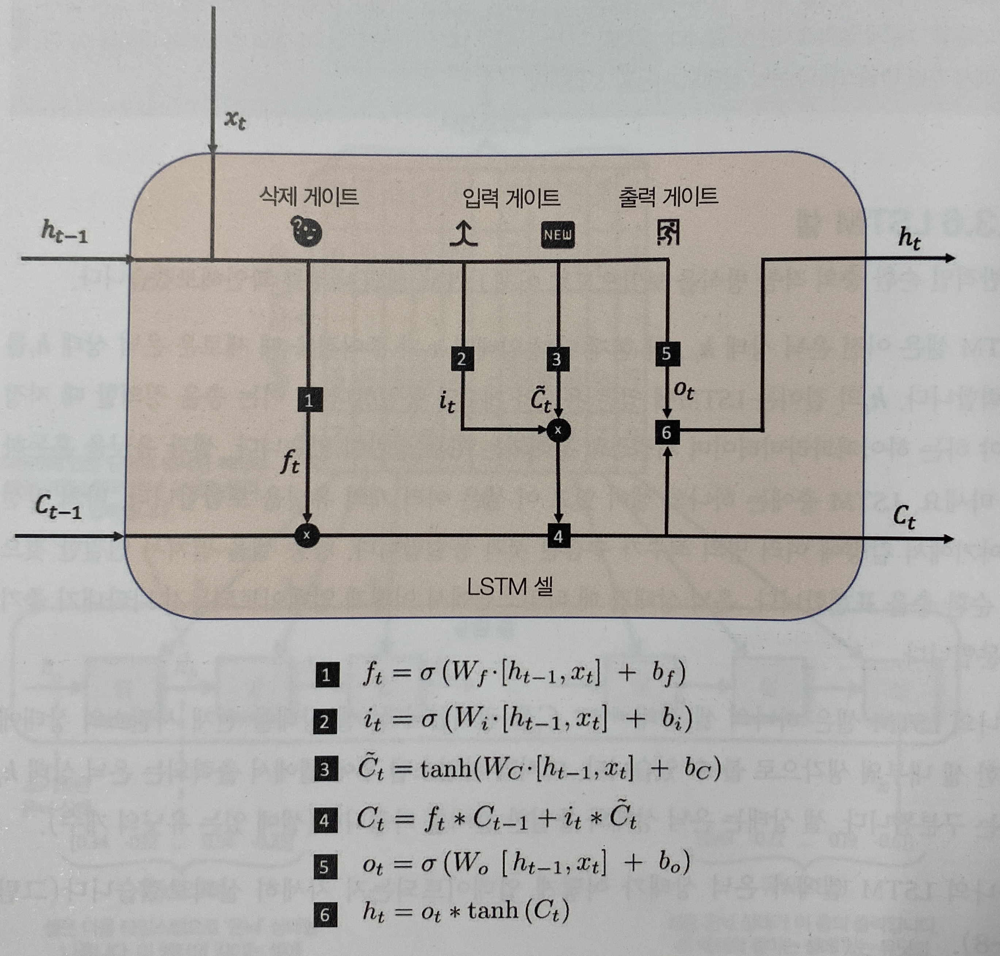

In [5]:
Image("img/4.jpg")

은닉 상태는 다섯 단계를 거쳐 업데이트 된다.

1) 이전 타임스텝 h_t-1의 은닉 상태는 현재 단어 임베딩 x_t와 연결되어 삭제 게이트(forget gate)로 전달된다. 이 게이트는 가중치 행렬 W_f, 절편 b_f와 시그모이드 활성화 함수를 가진 단순한 완전 연결 층이다. 결과 벡터 f_t는 셀의 유닛 개수와 길이가 동일하고 0과 1사이의 값을 가진다. 이 값은 이전 셀 상태 C_t-1을 얼마나 유지할지 결정한다.

2) 이 연결된 벡터는 입력 게이트(input gate)로도 전달된다. 삭제 게이트처럼 가중치 행렬 W_i,절편 b_i와 시그모이드 활성화 함수를 가진 완전 연결층이다. 이 게이트의 출력 i_t는 셀의 유닛과 동일하고 0과 1사이의 값을 가진다. 이 값은 이전 셀 상태 C_t-1에 얼마나 새로운 정보를 추가할지 결정한다.

3) 이 연결된 벡터는 가중치 행렬 W_c, 절편 b_c와 tanh 활성화 함수를 가진 또 다른 완전 연결 층으로 전달되어 ~C_t를 만든다. 이 벡터는 셀이 저장하려는 새로운 정보를 담고 있다. 역시 셀의 유닛 개수와 동일하고 -1과 1사이의 값을 갖는다.

4) f_t와 C_t-1을 원소별 곱셈한 다음 i_t와 ~C_t의 원소별 곱셈과 더한다. 이전 셀 상태의 일부분을 삭제하고 새로운 정보를 더해 업데이트된 셀 상태 C_t를 만드는 과정이다.

5) 이 연결 벡터는 가중치 행렬 W_o, 절편 b_o와 시그모이드 활성화 함수를 가진 완전 연결 층인 출력 게이트(output gate)로도 전달된다. 결과 벡터 o_t는 셀의 유닛 개수와 길이가 같고 0과 1사이의 값을 저장한다.이 값은 업데이트 된 셀 상태 C_t를 셀의 출력으로 얼마나 보낼지 결정한다.

6) 업데이트된 셀 상태 C_t는 tanh 활성화 함수가 적용된 다음 o_t와 원소별 곱셈하여 새로운 은닉 상태 h_t를 생성한다.

In [ ]:
# LSTM 네트워크 만들기

from keras.layers import Dense, LSTM, Input, Embedding, Dropout
from keras.models import Model
from keras.optimizers import RMSprop

n_units = 256
embedding_size = 100

text_in = Input(shape=(None,))
x=Embedding(total_words,embedding_size)(text_in)
x=LSTM(n_units)(x)
x=Dropout(0.2)(x)
text_out = Dense(total_words,activation = 'softmax')(x)  # 시퀀스 길이 아니고 왜 total_words? 

model = Model(text_in, text_out)
opti = RMSprop(lr = 0.001)
model.compile(loss = 'categorical_crossentropy',optimizer = opti)

epochs = 100
batch_size = 32
model.fit(X,y,epochs=epochs,batch_size = batch_size, shuffle = True)

# 6.4 새로운 텍스트 생성

이제 LSTM 네트워크를 컴파일하고 훈련해보자. 

다음 과정을 적용하여 이 네트워크로 긴 텍스트 문자열을 생성할 수 있다.

**1) 기존 단어의 시퀀스를 네트워크에 주입하고 다음 단어를 예측한다.**

**2) 이 단어를 기존 시퀀스에 추가하고 과정을 반복한다.**

이 네트워크는 샘플링할 수 있는 각 단어의 확률을 출력한다.

즉 결정적이지 않고 확률적으로 텍스트를 생성할 수 있다.

또한 temperature 매개변수를 사용하여 샘플링 과정을 얼마나 결정적으로 만들지 지정할 수 있다.

In [ ]:
# LSTM 네트워크로 텍스트 생성하기

def sample_with_temp(preds,temperature=1.0):  # 이 함수는 소프트맥스 함수를 다시 적용하기 전에 temperature 스케일 매개변수로 로짓에 가중치를 부여. temperature 값이 0에 가까울수록 샘플링을 더 결정적으로 만듦. 1에 가까우면 모델이 출력한 확률에 따라 단어가 선택됨
    #확률 배열에서 인덱스를 하나 샘플링 하는 헬퍼 함수
    preds=np.asaaray(preds).astype('float64')
    preds=np.log(preds) / temperature
    exp_preds= np.exp(preds)
    preds = exp_preds / np.sum(exp_preds)
    probs = np.random.multinomial(1,preds,1)
    return np.argmax(probs)
    
def generate_text(seed_text,next_words,model,max_sequence_len,temp):
    output_text = seed_text
    seed_text = start_story + seed_text   # seed_text는 생성과정을 시작하기 위해 모델에 전달할 단어 시퀀스. 이 값은 이야기의 시작을 나타내는 문자블럭 뒤에 덧붙여짐

    
    for _ in range(next_words):
        token_list = tokenizer.texts_to_sequence([seed_text])[0]  # 단어를 토큰의 리스트로 변환
        token_list = token_list[-max_sequence_len:]   # 마지막 amx_sequence_len개의 토큰만 유지. LSTM층이 어떤 길이의 시퀀스도 입력 받을 수 있음. 하지만 시퀀스가 길수록 다음 단어를 생성하는 데 시간이 많이 걸리므로 시퀀스 길이를 제한
        token_list = np.reshape(token_list,(1,max_sequence_len))
        
        probs = model.predict(token_list,verbose=0)[0]    # 모델은 시퀀스의 다음 단어에 대한 확률을 출력함
        y_class = sample_with_temp(probs,temperature = temp)   # 다음 단어를 출력하기 위해 샘플링 함수에 확률과 temperature 매개변수를 전달함
        
        output_word = tokenizer.index_word[y_class] if y_class >0 else ''
        if output_word == "|":   # 출력 단어가 스토리 시작 토큰이면 이야기가 끝나고 새로운 이야기를 시작해야하기 때문에 단어 생성을 멈춤
            break
        seed_text +=output_word + ' '  # 그렇지 않으면 새로운 단어를 seed_text에 덧붙이고 다음 생성 과정을 반복할 준비를 함
        output_text +=output_word+' '
    return output_text

# 6.4 RNN 확장

이번 절의 네트워크는 주어진 스타일로 텍스트 생성 방법을 학습하기 위해 LSTM이 어떻게 훈련되는지 보여주는 간단한 예이다.

## 6.5.1  적층 순환 네트워크

지금까지 하나의 LSTM 층이 포함된 네트워크를 보았지만 **LSTM 층을 쌓은 네트워크도 훈련할 수 있다.** 이로 인해 텍스트에서 더 깊은 특성을 학습할 수 있다.

이를 위해 첫 번째 LSTM 층의 return_sequences 매개변수를 True로 지정한다. 이렇게 하면 순환 층이 마지막 타임 스텝의 은닉 상태만 출력하지 않고 모든 타임스텝의 은닉 상태를 출력한다.

두 번째 LSTM 층은 첫 번째 층의 은닉 상태를 입력 데이터로 사용한다.

이 과정이 다음 그림에 나타나있다.

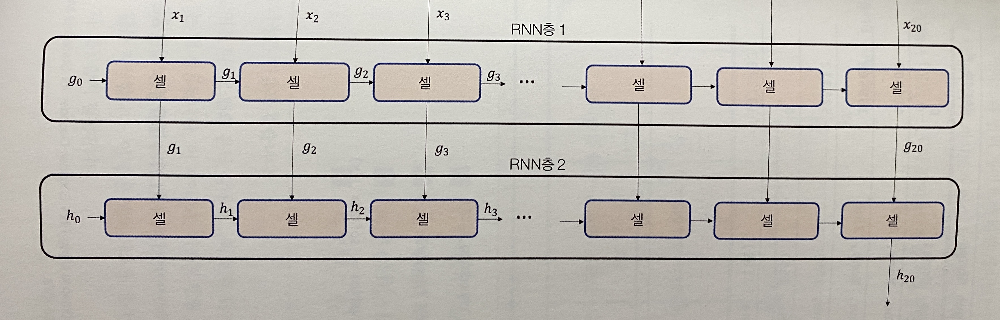

In [6]:
Image("img/5.jpg")

In [ ]:
# 적층 LSTM 네트워크 만들기

text_in = Input(shape = (None,))
    embedding = Embedding(total_words, embedding_size)
    x = embedding(text_in)
    x = LSTM(n_units, return_sequence = True)(x)
    x = LSTM(n_units)(x)
    text_out = Dense(total_words, activation = 'softmax')(x)
    
    model = Model(text_in, text_out)

적층 LSTM 네트워크 구조는 다음과 같다.

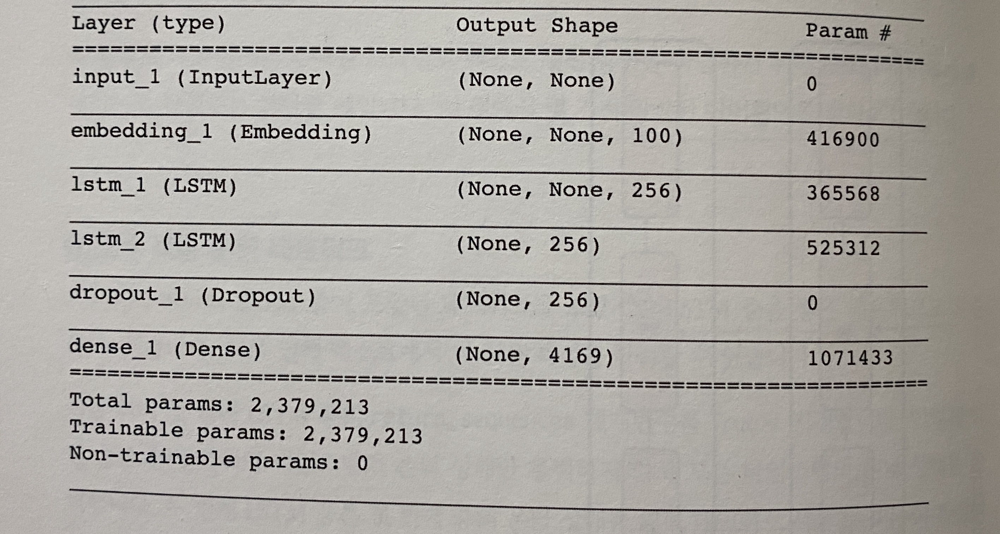

In [8]:
Image("img/6.jpg")

## 6.5.2 GRU 층

**널리 사용하는 또 다른 RNN층은 GRU(gated recurrent unit)이다.**

LSTM 셀과 주요 차이점은 다음과 같다.

1) 삭제 게이트와 입력 게이트가 리셋 게이트(reset gate)와 업데이트 게이트(update gate)로 바뀐다.

2) 셀 상태와 출력 게이트가 없다. 셀은 은닉 상태만 출력한다.

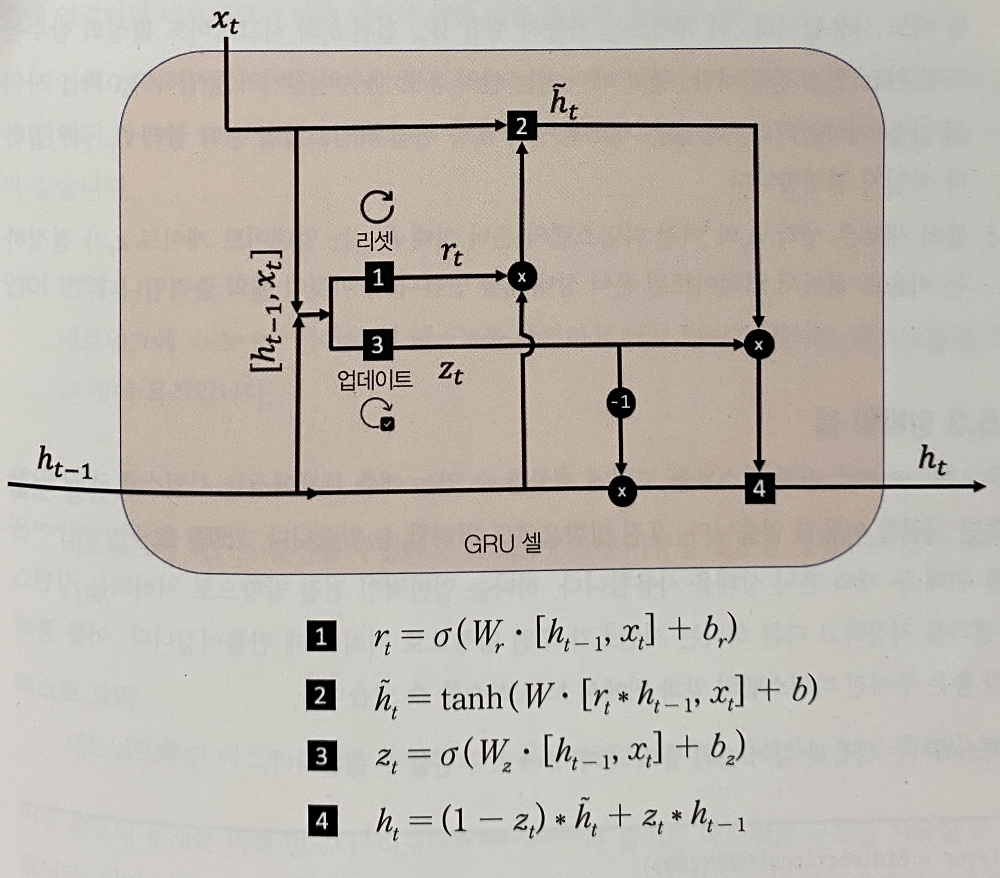

In [9]:
Image("img/7.jpg")   # GRU 셀

처리 과정은 다음과 같다.

1) 이전 타임 스텝의 은닉 상태 h_t-1과 현재 단어 임베딩 x_t가 연결되어 리셋 게이트를 만드는게 사용된다. 이 게이트는 가중치 행렬 W_r, 절편 b_r과 시그모이드 활성화 함수를 가진 완전 연결층이다. 결과 벡터 r_t는 셀의 유닛 개수와 길이가 동일하고 0과 1사이의 값을 저장한다. 이 값은 셀의 새로운 생각을 계산하는 데 이전 은닉 상태 h_t-1를 얼마나 제공할지 결정한다.


2) 리셋 게이트는 은닉 상태 h_t-1와 원소별 곱셈이 된 후 현재 단어 임베딩 x_t와 연결된다. 이 벡터는 가중치 행렬 W, 절편 b와 tanh 활성화 함수를 가진 완전 연결 층에 주입되어 셀의 새로운 생각을 저장하는 벡터 ~h_t를 생성한다. 이 벡터는 셀의 유닛 개수와 길이가 동일하고 -1에서 1사이의 값을 저장한다.


3) 이전 타임스텝의 은닉 상태 h_t-1과 현재 단어 임베딩 x_t의 연결은 업데이트 게이트를 만들 때도 사용된다. 이 게이트는 가중치 행렬 W_z, 절편 b_z와 시그모이드 활성화 함수를 가진 완전 연결 층이다. 결과 벡터 z_i는 셀의 유닛 개수와 길이가 동일하고 0과 1사이의 값을 저장한다. 이 값은 새로운 생각 ~h_t가 이전 타임스텝의 은닉 상태 h_t-1과 얼마나 섞일지 결정한다.


4) 셀의 새로운 생각 ~h_t와 이전 타임스텝의 은닉 상태 h_t-1는 업데이트 게이트 z_t가 결정하는 비율로 섞여서 업데이트된 은닉 상태 h_t를 만든다. 이것이 셀의 출력이다.

## 6.5.3 양방향 셀

추론 시 전체 텍스트를 모델에 제공할 수 있는 예측 문제에서는 시퀀스를 전진 방향으로만 처리할 이유가 없다. 후진 방향으로도 처리할 수 있다.

📍 *여기서 **추론**은 훈련된 모델을 사용하여 예측을 만드는 것을 말한다. 확률 분야에서 말하는 추론과는 다르다.*

양방향 층(bidirectional layer)은 이를 위해 두 개의 은닉 상태를 사용한다. 

하나는 일반적인 전진 방향으로 처리되는 시퀀스의 결과를 저장하고 다른 하나는 시퀀스가 후진 방향으로 처리될 때 만들어진다.

이를 통해 순환 층은 주어진 타입스텝의 앞과 뒤에서 모두 학습할 수 있다.

케라스에서는 다음과 같이 순환층의 래퍼(wrapper)로 구현할 수 있다.

In [ ]:
layer = Bidirectional(GRU(100))

만들어진 층의 은닉 상태는 셀 유닛 개수의 두배를 가진 벡터이다(전진 방향과 후진 방향의 은닉 상태를 연결한다). 

따라서 이 예에서 층의 은닉 상태는 길이가 200인 벡터이다.

# 6.6 인코더-디코더 모델

지금까지 주어진 시퀀스 이후의 텍스트를 생성하는 LSTM 네트워크를 알아보았다.

하나의 LSTM 층이 데이터를 순차적으로 처리하여 은닉 상태를 업데이트 하는 방법을 알아보았다.

**이 은닉 상태는 층이 가진 현재 시퀀스에 대한 지식이다.**

마지막 은닉 상태를 완전 연결층에 연결하면 네트워크가 다음 단어에 대한 확률 분포를 출력한다.

이 작업의 경우 시퀀스의 다음 단어 하나를 예측하는 것이 아니다.

대신 입력 시퀀스에 관련된 완전히 다른 단어의 시퀀스를 예측해야 한다.

이런 종류의 작업에 대한 예는 다음과 같다.

**[ 언어 번역 ]**

네트워크 소스(source) 언어로 된 텍스트를 주입하고 타깃 언어로 번역된 텍스트를 출력하는 것이 목적이다.

**[ 질문 생성 ]**

네트워크에 텍스트 문장을 주입하고 텍스트에 관해 가능한 질문을 생성하는 것이 목적이다.

**[ 텍스트 요약 ]**

네트워크에 긴 텍스트 문장을 주입하고 이 문장의 짧은 요약을 생성하는 것이 목적이다.

*이런 종류의 문제를 위해 인코더-디코더(encoder-decoder)라 불리는 네트워크 구조를 사용할 수 있다.*

순차 데이터에서 인코더 - 디코더 과정은 다음과 같이 동작한다.

1) 원본 입력 시퀀스는 인코더 RNN에 의해 하나의 벡터로 요약된다.

2) 이 벡터는 디코더 RNN의 초깃값으로 사용된다.

3) 각 타임스텝에서 디코더 RNN의 은닉상태는 완전 연결 층에 연결되어 단어 어휘 사전에 대한 확률 분포를 출력한다. 이런 식으로 인코더가 생성한 입력 데이터로 디코더를 초기화한 다음 새로운 텍스트 시퀀스를 생성할 수 있다.

이 과정이 다음 그림에 나타나있다. 그림은 영어를 독일어로 번역하는 예이다.

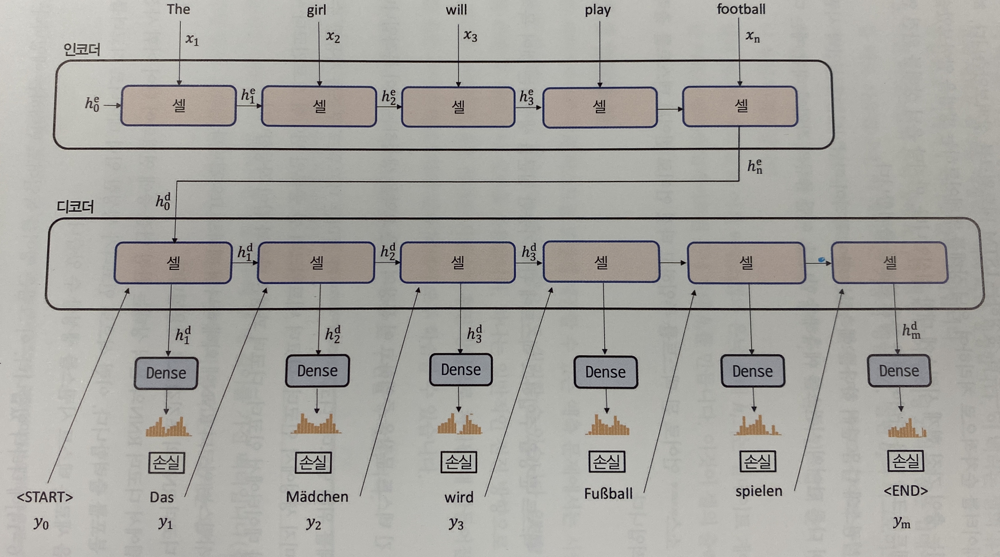

In [2]:
Image("img/8.jpg")

- 인코더의 마지막 은닉 상태는 전체 입력 문서에 대한 하나의 표현이라고 생각할 수 있다.


- 그 다음 디코더는 이 표현을 순차적인 출력으로 변환한다. 예를 들면 텍스트를 다른 언어로 번역하거나 이 문서에 대한 질문을 하는 것이다.



- 훈련하는 동안 각 타임스텝에서 디코더가 생성한 출력 분포를 진짜 다음 단어와 비교하여 손실을 계산한다.


- 훈련과정에서 디코더가 이 분포로부터 샘플링하여 다음 단어를 생성할 필요는 없다(이전 출력 분포에서 단어를 샘플링하는 대신 그 다음 타임스텝에 진짜 다음 단어가 셀에 주입되기 때문이다).


- 인코더 - 디코더 네트워크의 이런 훈련 방식을 **티처 포싱(teacher forcing)**이라고 한다. 


- 네트워크를 이따금 잘못된 분포를 예측하는 학생이라고 생각할 수 있다. 다음 단어를 예측하도록 선생님은 올바른 정답을 네트워크 입력으로 제공한다.

# 6.7 질문-대답 생성기

지금까지 배운 것을 모두 모아서 텍스트에 대한 질문과 대답을 생성하는 모델을 만들어보자.

이 모델은 두 개의 부분으로 구성된다.

  - RNN하나가 텍스트로부터 대답 후보를 고른다.
  
  
  - 인코더 - 디코더 네트워크가 RNN이 선택한 대답 후보 중 하나가 주어졌을 때 적절한 질문을 생성한다.

# 6.7.1 질문-대답 데이터셋

여기에서는 말루바(Maluuba) NewsQA 데이터셋을 사용할 것이다.

다운로드 받은 train.csv,test.csv,dev.csv는 모두 다음과 같은 열을 가진다.

- story_id : 스토리에 대한 고유 식별자


- story_text : 스토리의 텍스트(예를 들면, 'The winning goal was scored by 23-year-old striker Joe Bloggs during the match..~).


- question : 스토리 텍스트에 대한 질문(예를 들면, 'How much did the striker cost?').


- answer_token_ranges : 스토리 텍스트에서 대답의 토큰 위치(예를 들면, 24:27). 대답이 스토리에 여러 번 등장하면 한 개 이상의 범위가 있을 수 있다(콤마로 구분). 모델의 입력으로 사용하기 위해 이 원본 데이터를 전처리하고 토큰화한다. 변환한 후에 훈련 세트에 있는 각 샘플은 다음과 같은 다섯 개의 특성으로 구성된다.

- document_tokens : 토큰화된 스토리 텍스트(예를 들면,1, 4633, 7, 66, 11, ...~]). max_document_length(파라미터)길이로 클리핑 되거나 제로패딩 된다.


- question_input_tokens : 토큰화된 질문(예를 들면, [2, 39, 1, 52, ...~ ]). max_question_length(또 다른 파라미터)길이로 제로 패딩된다.


- question_output_tokens : 한 타임스텝 밀린 토큰화된 질문(예를 들면, [39, 1, 52, 1866, ...~ ]). max_question_length 길이로 제로 패딩된다.


- answer_masks : [max_answer_length, max_document_length]크기의 이진 마스크 행렬. 질문에 대한 대답의 i번째 단어가 문서 j번째 단어에 있다면 이 행렬의 [i,j]의 값이 1이고 그렇지 않다면 0이다.


- answer_labels : max_document_length길이의 이진벡터(예를 들면, [0,1,1,0,..~]). 문서의 i번째 단어가 대답의 일부분이면 이 벡터의 i번째 원소가 1이고 그렇지 않으면 0 이다.

텍스트가 주어졌을 때 질문 - 대답 쌍을 생성할 수 있는 모델 구조를 알아보자.

# 6.7.2 모델 구조

앞으로 만들 전체 모델 구조는 다음과 같다.

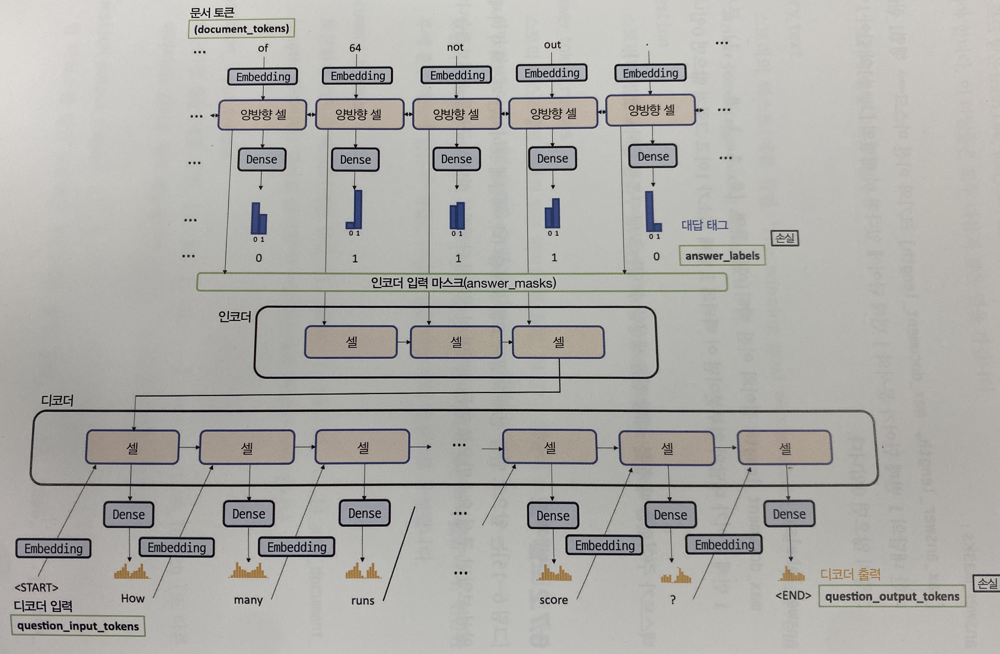

In [3]:
Image("img/9.jpg")

먼저 앞 그림에 있는 상단 모델의 구성 요소를 만드는 케라스 코드를 살펴보자. 

In [ ]:
#  질문-대답 쌍을 생성하기 위한 모델 구조

from keras.layers import Input,Embedding,GRU, Bidirectional, Dense, Lambda
from keras.models import Model, load_model
import keras.backend as K
from qgen.embedding import glove

# 파라미터
VOCAB_SIZE = glove.shape [0]   # 9984
EMBEDDING_DIMENS = glove.shape [1]   # 100
GRU_UNITS = 100
DOC_SIZE = None
ANSWER_SIZE = None
Q_SIZE = None

document_tokens = Input(shape=(DOC_SIZE,), name = "documet_tokens")
embedding = Embedding(input_dim = VOCAB_SIZE, output_dim = EMBEDDING_DIMENS, weights=[glove], mask_zero=True, name = 'embedding')   # 임베딩 층을 GloVe 단어 벡터로 초기화
document_emb = embedding(document_tokens)

answer_outputs = Bidirectional(GRU(GRU_UNITS, return_sequences = True), name = 'answer_outputs')(document__emb)  # 순환 층은 각 타임스텝의 은니 상태를 반환하는 양방향 GRU
answer_tags = Dense(2,activation = 'softmax', name = 'answer_tags')(answer_outputs)   # 출력 Dense층은 각 타임스텝의 은닉 상태에 연결됨. 이 층은 두 개의 유닛과 소프트맥스 활성화 함수로 이루어짐. 각 단어가 대답의 일부분인지(1) 또는 아닌지(0)에 대한 확률을 표현

**Glove 단어 벡터란 ?** 

앞서 보았듯이 임베딩 층을 랜덤한 벡터 대신 사전 훈련된 단어 임베딩으로 초기화한다. 이 단어는 스탠퍼드 GloVe 프로젝트에서 비지도 학습 방법으로 대규모 단어 집합에 대한 표현 벡터를 만든 것이다. 이 벡터는 단어 사이를 연결하는 벡터에 있는 유사도와 같이 유용한 성질이 많다. 예를 들어 man과 woman 단어의 임베딩 사이를 연결하는 벡터는 king과 queen 단어의 임베딩을 연결한 벡터와 거의 동일하다. 단어 벡터가 존재하는 잠재 공간에 단어의 성별이 인코딩된 것처럼 볼 수 있다. 임베딩 층을 GloVe로 초기화하면 처음부터 훈련하는 것보다 종종 더 좋은 성능을 낸다. 단어 표현을 잡아내기 위한 어려운 많은 작업을 GloVe 훈련 과정에서 이미 수행했기 때문이다. 그다음 자신의 머신 러닝 문제에 맞도록 단어 임베딩을 수정할 수 있다.

모델의 두번째 부분은 대답을 받고 이에 대한 질문을 구성하는 **인코더 - 디코더 네트워크이다.**

In [ ]:
# 대답이 주어졌을 때 질문을 구성하는 인코더-디코더 네트워크의 모델

encoder_input_mask = Input(shape = (ANSWER_SIZE, DOC_SIZE),name = "encoder_input_mask")
encoder_inputs = Lambda(lambda x:K.batch_dot(x[0],x[1]), name = "encoder_inputs")([encoder_input_mask, answer_outputs])
encoder_cell = GRU(2 * GRU_UNITS, name = 'encoder_cell')(encoder_inputs)   # 인코더는 주어진 대답의 범위에 대한 은닉 상태를 입력으로 사용하는 GRU층

decoder_inputs = Input(shape = (Q_SIZE,), name = "decoder_inputs")   # 디코더의 입력 데이터는 주어진 대답의 범위에 매칭되는 질문
decoder_emb = embedding(decoder_inputs)   # 질문의 단어 토큰은 대답 식별 모델에서 사용한 동일한 임베딩 층을 통과
decoder_emb.trainable = False
decoder_cell = GRU(2 * GRU_UNITS, return_sequences = True, name = 'decoder_cell')
decoder_states = decoder_cell (decoder_emb,initial_state=[encoder_cell])  # 디코더는 GRU층이고 인코더의 마지막 은닉 상태로 초기화됨

decoder_projection = Dense(VOCAB_SIZE ,name = 'decoder_projection', activation = 'softmax', use_bias = False)
docoder_outputs = decoder_projection(decoder_states)   # 디코더의 은닉 상태는 Dense층을 통과해 시퀀스의 다음 단어를 위해 전체 어휘 사전에 대한 분포를 생성

total_model = Model([document_tokens, decoder_inputs, encoder_input_mask],[answer_tags, decoder_outputs])
answer_model = Model(document_tokens, [answer_tags])
decoder_initial_state_model = Model([document_tokens, encoder_input_mask],[encoder_cell])

질문-대답 쌍 생성 네트워크를 완성했다. 

이 네트워크를 훈련하려면 문서 텍스트, 질문 텍스트, 대답 마스크를 입력 데이터로 함께 전달한다.

그다음 동일한 가중치를 부여하여 대답의 위치 에측과 질문의 단어 생성에 대한 크로스 엔트로피 손실을 최소화한다.

# 6.7.3 예측

이전에 본 적 없는 입력 문서 시퀀스에서 모델을 테스트하기 위해 다음 과정을 수행해야한다.

1) 대답 생성기에 문서 텍스트를 주입하여 대답 샘플 위치를 생성한다.


2) 이 대답 중 하나를 선택하여 인코더-디코더 질문 생성기로 전달한다(즉 적절한 대답 마스크를 만든다).


3) 문서와 대답 마스크를 인코더에 주입하여 디코더의 초기 상태를 생성한다.


4) 이 초기 상태로 디코더를 초기화하고 < START > 토큰을 주입하여 질문의 첫 번째 단어를 생성한다. 모델이 < END > 토큰을 예측할 때까지 생성된 단어를 주입하여 이 과정을 반복한다.



- 앞서 언급한 것처럼 훈련하는 동안 이 모델은 다음 단어를 예측하는 대신 티처 포싱을 사용하여 정답 단어를 디코더 셀로 주입한다.


- 하지만 예측에서는 모델이 질문을 스스로 생성해야한다.


- 따라서 은닉 상태를 유지하면서 예측된 단어로 다시 디코더 셀로 주입할 수 있어야한다.


- **이를 처리하는 한가지 방법은 또 다른 케라스 모델을 하나 정의하는 것이다. 이 모델은 현재 단어 토큰과 현재 디코더의 은닉 상태를 입력으로 받으며 예측된 다음 단어의 분포를 출력하고 디코더의 은닉 상태를 업데이트한다.**

In [ ]:
# 예측 모델

decoder_inputs_dynamic = Input(shape = (1,), name = "decoder_inputs_dynamic")   
decoder_emb_dynamic = embedding(decoder_inputs_dynamic)   
decoder_init_state_dynamic = Input(shape = (2 *GRU_UNITS,),name = 'decoder_init_state_dynamic')
decoder_states_dynamic = decoder_cell (decoder_emb_dynamic,initial_state=[decoder_init_state_dynamic])  
docoder_outputs_dynamic = decoder_projection(decoder_states_dynamic)   

question_model = Model([decoder_inputs_dynamic, decoder_init_state_dynamic],[decoder_outputs_dynamic, decoder_states_dynamic])

In [ ]:
# 주어진 문서로부터 질문-대답 쌍 생성하기

test_data_gen = test_data()
batch = next(test_data_gen)
answer_preds = answer_model.predict(batch["document_tokens"])

idx = 0
start_answer = 37
end_answer = 39

answers = [[0]*len(answer_preds[idx])]
for i in rnage(start_answer, end_answer +1):
    answers[idx][i] = 1
    
answer_batch = expad_answers(batch,answers)

next_decoder_init_state = decoder_initial_state_model.predict([answer_batch['document_tokens'][[idx]],answer_batch['answer_masks'][[idx]]])

word_todkens = [START_TOKEN]
questions = [look_up_token(START_TOKEN)]

ended = False

while not ended :
    word_preds,nex_decoder_init_state = questio_model.predict([word_tokens,next_decoder_init_state])
    next_decoder_init_state = np.squeeze(nxt_decoder_init_state,axis = 1)
    word_tokens = np.argmax(word_preds,2)[0]
    questios.append(look_up_token(word_tokens[0]))
    if word_tokens[0]== END_TOKEN :
        ended = True
        
questions = ' '.join(questions)

# 6.7.4 모델 결과

다음 그림은 모델의 샘플 결과이다.

- 오른쪽 그래프는 모델이 만든 대답을 구성하는 각 단어의 확률이다.


- 대답은 질문 생성기로 주입되고 모델의 출력(예측 질문)은 그림의 왼쪽 편에 나타나 있다.


- 먼저 대답 생성기가 문서의 대답에 포함될 가능성이 가장 높은 단어를 얼마나 정확하게 감지하는지 볼 수 있다.


- 이전에 이 텍스트를 본적이 없고 대답에 포함된 'Bloggs'같은 특정 단어를 본 적이 없기 때문에 매우 놀랍다.


- 사람 이름의 성으로 보이는 문맥을 이해할 수 있기 때문에 대답으로 선정된 것 같다.

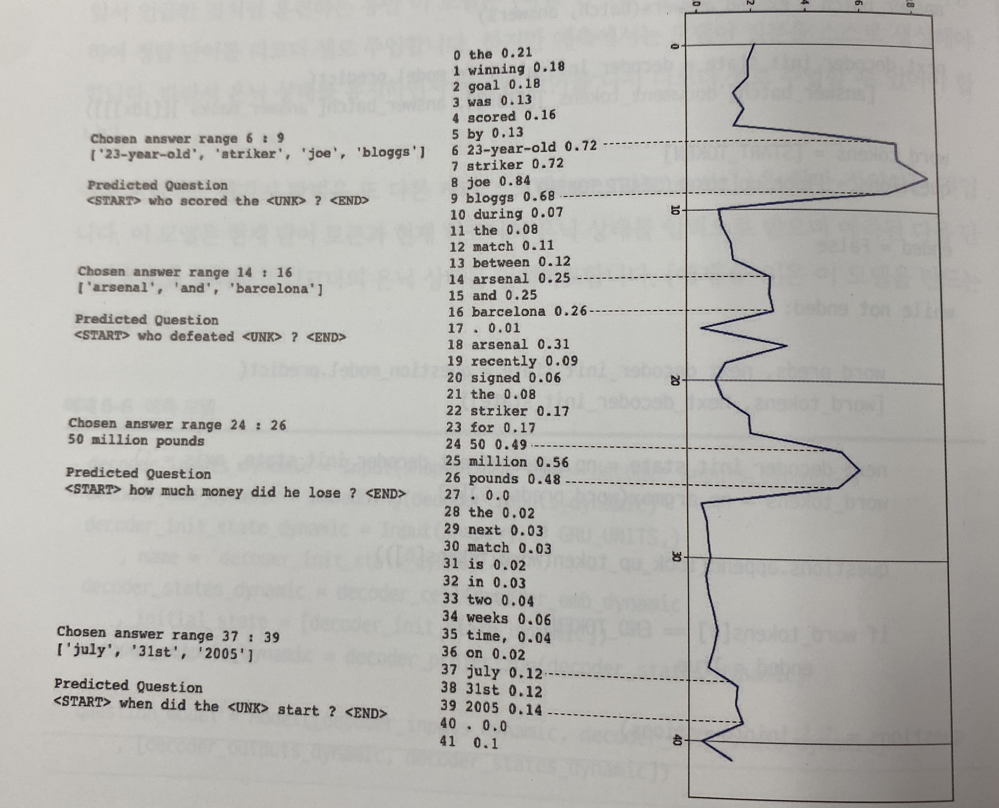

In [4]:
Image("img/10.jpg")

인코더가 가능한 대답으로부터 문맥을 추출하기 때문에 디코더는 이에 맞는 질문을 생성할 수 있다.

인코더가 첫 번째 대답으로 언급한 사람 23-year-old striker Joe Bloggs를 감지할 수 있다는 점이 놀랍다.

인코더는 맥락을 디코더에 전달해 'who scored the < UNK >?'와 같은 질문을 생성할 수 있다.
    
디코더는 질문을 < UNK > 태그로 마쳤다. 이는 다음에 무엇이 나올지 모르기 때문이 아니다. 어휘 사전에 없는 단어를 예측한 것이다.
    
원본 문서 데이터셋에서 희귀한 단어를 이런 식으로 토큰화했기 때문에 모델이 < UNK > 태그를 사용하는 것은 놀라울 일이 아니다.
    
모델의 정확도와 생성 능력을 향상시키기 위해 인코더-디코더 네트워크를 생성한게 많다. 가장 널리 사용하는 것 중 두 가지는 **포인터 네트워크**와 **어텐션 메커니즘**이다. 

   - 포인터 네트워크에서는 어휘 사전에 있는 단어에만 의존하는 것이 아니라 모델이 생성된 질문에 포함할 입력 텍스트의 특정 단어를 '포인팅'할 수 있다 => 앞에서 언급한 < UNK > 문제를 해결하는데 도움이 된다.
   
   
   - 어텐션 메커니즘은 다음 장에서 자세히 살펴본다.